In [0]:
!pip install lime

     |████████████████████████████████| 276kB 2.7MB/s 
     |████████████████████████████████| 2.0MB 6.4MB/s 
  Created wheel for lime: filename=lime-0.2.0.0-cp36-none-any.whl size=284181 sha256=c341e82541b054abfc2b84f25768faf4b307e65917b0e9ebea9a432490a10f3d
  Stored in directory: /root/.cache/pip/wheels/22/f2/ec/e5ebd07348b2b1ac722e91c2f549fcc220f7d5f25497a61232
Successfully built lime
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [0]:
!pip install shap

     |████████████████████████████████| 276kB 2.4MB/s 
  Created wheel for shap: filename=shap-0.35.0-cp36-cp36m-linux_x86_64.whl size=394121 sha256=f2da82ca2a624ff7bdfd265ffb9ecf9b7e24e62fdf03ebf3179f67dc49b8641b
  Stored in directory: /root/.cache/pip/wheels/e7/f7/0f/b57055080cf8894906b3bd3616d2fc2bfd0b12d5161bcb24ac
Successfully built shap


In [0]:
!pip install anchor_exp

     |████████████████████████████████| 430kB 2.7MB/s 
  Created wheel for anchor-exp: filename=anchor_exp-0.0.1.0-cp36-none-any.whl size=434742 sha256=8d1215d2b07acc4099007dbcb53c5dddb42e817b1d420079fa9623b90ba20875
  Stored in directory: /root/.cache/pip/wheels/ff/b7/cd/7bfb36f4a01ff6b1509cd3432f8b208f455d232cee1079e309
Successfully built anchor-exp


# **Data Exploration and preprocessing**

US Arilines Sentiment dataset  https://www.kaggle.com/crowdflower/twitter-airline-sentiment

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns
import string
import regex as re
from nltk.tokenize import word_tokenize

%matplotlib inline

In [0]:
def remove_punctuation(word):
    for punkt in list(string.punctuation):
        word = word.replace(punkt, '')
        
    return word


In [0]:
def cleansing(text):
    word_list = word_tokenize(text)
    word_list = [word for word in word_list if len(word) > 1]
    word_list = [remove_punctuation(word) for word in word_list]
    text = text.lower()
    text = re.sub(r"(?:\@|http?\://|https?\://|www)\S+", "", text)
    text = re.sub(r'#\w+ ?', '', text)
    text = ' '.join(word_list)
    
    
    return text

In [0]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [0]:
import pandas as pd

# Read data into papers
col = ['airline_sentiment', 'text']
df = pd.read_csv('Tweets.csv',usecols=col)


# Print head
df.head()

,airline_sentiment,text
0,2,@VirginAmerica What @dhepburn said.
1,1,@VirginAmerica plus you've added commercials t...
2,2,@VirginAmerica I didn't today... Must mean I n...
3,0,@VirginAmerica it's really aggressive to blast...
4,0,@VirginAmerica and it's a really big bad thing...


In [0]:
df['text'] = df.text.apply(cleansing)


In [0]:
from sklearn.model_selection import train_test_split
train_df, test_df = train_test_split(df, test_size=0.2)


x_train = train_df['text'].values
y_train = train_df['airline_sentiment'].values
x_test = test_df['text'].values
y_test = test_df['airline_sentiment'].values



In [0]:
train_df.shape

(11712, 2)

In [0]:
test_df.shape

(2928, 2)

# **Classification Model**



# **Bi-LSTM MODEL**

In [0]:
!pip install spacy

In [0]:
! python -m spacy download en_core_web_lg

     |████████████████████████████████| 827.9MB 1.2MB/s 
  Created wheel for en-core-web-lg: filename=en_core_web_lg-2.2.5-cp36-none-any.whl size=829180944 sha256=af172060890e753d146503bf79a18d4b2b8460d980d23da0737c63fad0923e7e
  Stored in directory: /tmp/pip-ephem-wheel-cache-zzj98bs5/wheels/2a/c1/a6/fc7a877b1efca9bc6a089d6f506f16d3868408f9ff89f8dbfc
Successfully built en-core-web-lg
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_lg')


In [0]:
from sklearn.base import BaseEstimator, TransformerMixin
from keras.models import Model, Input
from keras.layers import Dense, LSTM, Dropout, Embedding, SpatialDropout1D, Bidirectional, concatenate, Flatten
from keras.layers import GlobalAveragePooling1D, GlobalMaxPooling1D
from keras.utils.vis_utils import plot_model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from sklearn.metrics import accuracy_score
import regex as re
import numpy as np
class KerasTextClassifier(BaseEstimator, TransformerMixin):
    '''Wrapper class for keras text classification models that takes raw text as input.'''
    
    def __init__(self, max_words=30000, input_length=100, emb_dim=20, n_classes=3, epochs=5, batch_size=32):
        self.max_words = max_words
        self.input_length = input_length
        self.emb_dim = emb_dim
        self.n_classes = n_classes
        self.epochs = epochs
        self.bs = batch_size
        self.classes_ = None
        self.model = self._get_model()
        self.tokenizer = Tokenizer(num_words=self.max_words+1,
                                   lower=True, split=' ', oov_token="UNK")
    
    def _get_model(self):
        input_text = Input((self.input_length,))
        text_embedding = Embedding(input_dim=self.max_words + 2, output_dim=self.emb_dim,
                                   input_length=self.input_length, mask_zero=False)(input_text)
        text_embedding = SpatialDropout1D(0.5)(text_embedding)
        bilstm = Bidirectional(LSTM(units=32, return_sequences=True, recurrent_dropout=0.5))(text_embedding)
        flatten_layer = Flatten()
        x= flatten_layer(bilstm)
        x = Dense(512, activation="relu")(x)
        x = Dropout(0.5)(x)
        out = Dense(units=self.n_classes, activation="softmax")(x)
        model = Model(input_text, out)
        model.compile(optimizer="adam",
                      loss="sparse_categorical_crossentropy",
                      metrics=["accuracy"])
        plot_model(model, to_file='model_plot.png',show_shapes=True, show_layer_names=True)
        return model
    
    def _get_sequences(self, texts):
        seqs = self.tokenizer.texts_to_sequences(texts)
        return pad_sequences(seqs, maxlen=self.input_length, value=0)
    
    def _preprocess(self, texts):
        return [re.sub(r"\d", "DIGIT", x) for x in texts]
    
    def fit(self, X, y):
        '''
        Fit the vocabulary and the model.
        
        :params:
        X: list of texts.
        y: labels.
        '''
        
        self.tokenizer.fit_on_texts(self._preprocess(X))
        self.tokenizer.word_index = {e: i for e,i in self.tokenizer.word_index.items() if i <= self.max_words}
        self.tokenizer.word_index[self.tokenizer.oov_token] = self.max_words + 1
        seqs = self._get_sequences(self._preprocess(X))
        self.model.fit(seqs, y, batch_size=self.bs, epochs=self.epochs, validation_split=0.1)
    
    def predict_proba(self, X, y=None):
        seqs = self._get_sequences(self._preprocess(X))
        return self.model.predict(seqs)
    
    def predict(self, X, y=None):
        return np.argmax(self.predict_proba(X), axis=1)
    
    def score(self, X, y):
        y_pred = self.predict(X)
        return accuracy_score(y, y_pred)
    
    def trasnform(self, X):
        return self._get_sequences(self._preprocess(X))

    def _encode_label(self, y):
        return self.label_encoder.transform(y)
        
    def _decode_label(self, y):
        return self.label_encoder.inverse_transform(y)

    def _init_label_encoder(self, y):
        self.label_encoder = LabelEncoder()
        self.label_encoder.fit(y)
        self.classes_ = self.label_encoder.classes_

    def _encode_feature(self, x):
        self.tokenizer.fit_on_texts(self._preprocess(x))
        self.tokenizer.word_index = {e: i for e,i in self.tokenizer.word_index.items() if i <= self.word_cnt}
        self.tokenizer.word_index[self.tokenizer.oov_token] = self.word_cnt + 1
        return self._get_sequences(self._preprocess(x))

    def predict_decode(self, X, y=None):
        return self._decode_label(self.predict(X))
        
    def summary(self):
       return self.model.summary()

In [0]:
text_model = KerasTextClassifier(epochs=5, max_words=20000, input_length=200)


In [0]:
text_model.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 200)               0         
_________________________________________________________________
embedding_2 (Embedding)      (None, 200, 20)           400040    
_________________________________________________________________
spatial_dropout1d_2 (Spatial (None, 200, 20)           0         
_________________________________________________________________
bidirectional_3 (Bidirection (None, 200, 64)           13568     
_________________________________________________________________
flatten_1 (Flatten)          (None, 12800)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 512)               6554112   
_________________________________________________________________
dropout_2 (Dropout)          (None, 512)               0   

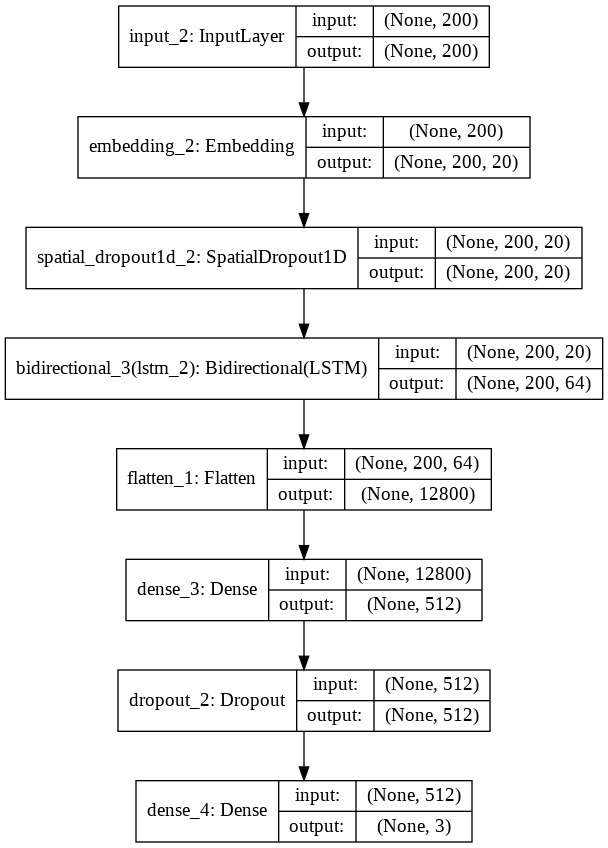

In [0]:
from IPython.display import Image
Image(filename='model_plot.png') 

In [0]:
text_model.fit(x_train, y_train)

Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.


Train on 10540 samples, validate on 1172 samples
Epoch 1/5
10540/10540 [==============================] - 86s 8ms/step - loss: 0.7422 - accuracy: 0.6858 - val_loss: 0.5678 - val_accuracy: 0.7645
Epoch 2/5
10540/10540 [==============================] - 86s 8ms/step - loss: 0.5047 - accuracy: 0.7968 - val_loss: 0.5008 - val_accuracy: 0.7961
Epoch 3/5
10540/10540 [==============================] - 85s 8ms/step - loss: 0.4033 - accuracy: 0.8472 - val_loss: 0.5109 - val_accuracy: 0.8055
Epoch 4/5
10540/10540 [==============================] - 86s 8ms/step - loss: 0.3218 - accuracy: 0.8819 - val_loss: 0.5293 - val_accuracy: 0.7927
Epoch 5/5
10540/10540 [==============================] - 86s 8ms/step - loss: 0.2745 - accuracy: 0.9028 - val_loss: 0.5716 - val_accuracy: 0.7850


In [0]:
text_model.score(x_test, y_test)


0.798155737704918

### **Explaining with SHAP Explaination (kernel Explaination)**


In [0]:
encoded_x_train = text_model.trasnform(x_train)
encoded_x_test = text_model.trasnform(x_test)

In [0]:
def prepare_explanation_words(pipeline, encoded_x):
    words = text_model.tokenizer.word_index
    num2word = {}
    for w in words.keys():
        num2word[words[w]] = w
    x_test_words = np.stack([
        np.array(list(map(
            lambda x: num2word.get(x, "NONE"), encoded_x[i])
                     )) for i in range(10)])

    return x_test_words

In [0]:
import shap
shap.initjs()
kernel_explainer = shap.KernelExplainer(text_model.model.predict, encoded_x_train[:10])
kernel_shap_values = kernel_explainer.shap_values(encoded_x_test[:10])

x_test_words = prepare_explanation_words(text_model, encoded_x_test)
y_pred = text_model.predict(x_test[:10])

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


In [0]:
shap.initjs()
print('Actual Category: %s, Predict Category: %s' % (y_test[6], y_pred[6]))

shap.force_plot(kernel_explainer.expected_value[0], kernel_shap_values[0][6], x_test_words[6])

Actual Category: 2, Predict Category: 2


In [0]:
shap.initjs()
print('Actual Category: %s, Predict Category: %s' % (y_test[5], y_pred[5]))

shap.force_plot(kernel_explainer.expected_value[0], kernel_shap_values[0][5], x_test_words[5])

Actual Category: 0, Predict Category: 0


In [0]:
shap.initjs()
print('Actual Category: %s, Predict Category: %s' % (y_test[2], y_pred[2]))

shap.force_plot(kernel_explainer.expected_value[0], kernel_shap_values[0][2], x_test_words[2])

Actual Category: 0, Predict Category: 0


#### **Explain the Visualization**




*   The "model output value" is the prediction of the explainer above. Similar to LIME explainer, the prediction is 85%. 


*   According to [paper](http://papers.nips.cc/paper/7062-a-unified-approach-to-interpreting-model-predictions.pdf) , the base value of 0.64 is the mean of prediction of all y_test. That is why, the value is not differ from all of three examples.
*   Red or Blue Features that push the prediction higher (to the right) are shown in red, and those pushing the prediction lower are in blue.

*   Similar to LIME, SHAP also has large attributes on "not" , "guys", and etc

*   This force plot of Kernel Explanation explains how different features pushed and pulled on the output to move it from the base_value to the model output value or prediction. The prediction of this kernel explanation is the probability or confidence that the review is 85% belong to predicted category  ("Negative" Class).

*   Above, the word "not", "guys", "but", etc, on the left-hand side pushing the prediction from the base value 0.64 close to 1 and "much" , "yes" are pushing in the other direction. We can see that from the base value of 0.64, the features have pushed and pulled to bring the output to 0.85.



## **Explaining with Lime**

Sample 6: last 80 words (only part used by the model)
--------------------------------------------------
USAirways what about AA miles for USAir flights booked through American
--------------------------------------------------
Probability(positive) = 0.07620695
True class:  2


split() requires a non-empty pattern match.


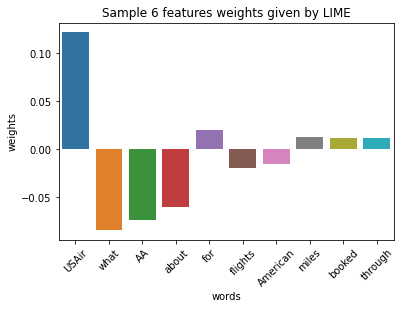

In [0]:
import seaborn as sns
%matplotlib inline
from collections import OrderedDict
from lime.lime_text import LimeTextExplainer

import seaborn as sns
sns.despine()
# We choose a sample from test set
idx =6
idx2 =5
idx3=2
text_sample = x_test[idx]
text_sample2 = x_test[idx2]
text_sample3 = x_test[idx3]
class_names = ['Negative', 'Positive','Neutral']

print('Sample {}: last 80 words (only part used by the model)'.format(idx))
print('-'*50)
print(" ".join(text_sample.split()[-80:]))
print('-'*50)
print('Probability(positive) =', text_model.predict_proba([text_sample])[0,1])
print("True class: ",y_test[idx])

explainer = LimeTextExplainer(class_names=class_names)
explanation = explainer.explain_instance(text_sample, text_model.predict_proba, num_features=10)

weights = OrderedDict(explanation.as_list())
lime_weights = pd.DataFrame({'words': list(weights.keys()), 'weights': list(weights.values())})



sns.barplot(x="words", y="weights", data=lime_weights);
plt.xticks(rotation=45)
plt.title('Sample {} features weights given by LIME'.format(idx));

In [0]:
explanation.show_in_notebook(text=True)

Sample 5: last 80 words (only part used by the model)
--------------------------------------------------
united missing this wedding because of these delays would not be cool
--------------------------------------------------
Probability(positive) = 0.0032373613
True class:  0


split() requires a non-empty pattern match.


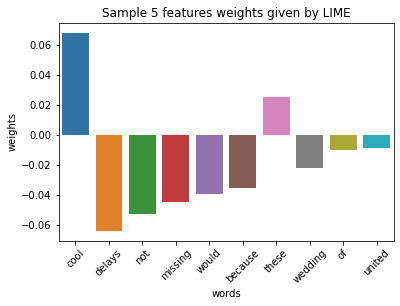

In [0]:
print('Sample {}: last 80 words (only part used by the model)'.format(idx2))
print('-'*50)
print(" ".join(text_sample2.split()[-80:]))
print('-'*50)
print('Probability(positive) =', text_model.predict_proba([text_sample2])[0,1])
print("True class: ",y_test[idx2])

explainer = LimeTextExplainer(class_names=class_names)
explanation = explainer.explain_instance(text_sample2, text_model.predict_proba, num_features=10)

weights = OrderedDict(explanation.as_list())
lime_weights = pd.DataFrame({'words': list(weights.keys()), 'weights': list(weights.values())})



sns.barplot(x="words", y="weights", data=lime_weights);
plt.xticks(rotation=45)
plt.title('Sample {} features weights given by LIME'.format(idx2));


In [0]:
explanation.show_in_notebook(text=True)

Sample 2: last 80 words (only part used by the model)
--------------------------------------------------
AmericanAir yes but not with much help from you guys
--------------------------------------------------
Probability(positive) = 0.043634728
True class:  0


split() requires a non-empty pattern match.


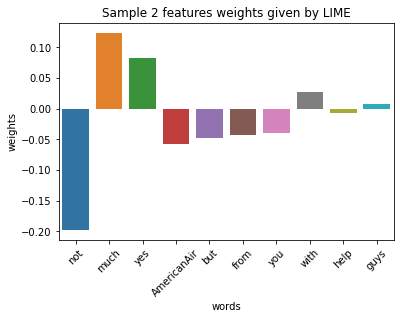

In [0]:
print('Sample {}: last 80 words (only part used by the model)'.format(idx3))
print('-'*50)
print(" ".join(text_sample3.split()[-80:]))
print('-'*50)
print('Probability(positive) =', text_model.predict_proba([text_sample3])[0,1])
print("True class: ",y_test[idx3])

explainer = LimeTextExplainer(class_names=class_names)
explanation = explainer.explain_instance(text_sample3, text_model.predict_proba, num_features=10)

weights = OrderedDict(explanation.as_list())
lime_weights = pd.DataFrame({'words': list(weights.keys()), 'weights': list(weights.values())})



sns.barplot(x="words", y="weights", data=lime_weights);
plt.xticks(rotation=45)
plt.title('Sample {} features weights given by LIME'.format(idx3));

In [0]:
explanation.show_in_notebook(text=True)

###Explain the Explainer Visualization



*   On the "Text with higligted words", the blue words made the classifier think that the review was more negative while the yellow words made the review seem more positive.
*   For this review, word “not” has the highest negative score for class Negative. We are able to see it clearly that the word “not” on its own is a negative signal but the phrase “AmericanAir yes ...” is a very positive signal. And the “but” is such a strong negative signal because it negates the word “yes” and any positive word before.

*   The explainer predicts that this review should be labeled as "negative" with the probability of 85%.
*   The word "not" support 20% for "Negative" probabilites prediction the if we remove it from the review the probability will drop to 65% for "Negative" class. (85%-20%).



With LIME methods of explanation, it is easy for Human to intrepret and understand the prediction. LIME allows us to extract some important word that mostly contribute to the prediction, and even give the rational number "Negative" or "Positive" contribution of each word of sample.

## Explaining with Anchor

In [0]:
from anchor import anchor_text

In [0]:
import random
import spacy
spacy_nlp = spacy.load('en_core_web_lg')

In [0]:
sample_ids = [6]
for idx in sample_ids:
  print('Index: %d, Feature: %s' % (idx, x_test[idx]))
  print('True Label: %s' % (y_test[idx]))
  class_names = ['negative','positive','neutral']
  estimator = text_model.predict
  explainer = anchor_text.AnchorText(spacy_nlp, class_names, use_unk_distribution=True)
  exp = explainer.explain_instance(x_test[idx], estimator, threshold=0.8, use_proba=True, batch_size=30)
  max_pred = 2
  print('Key Singal from Anchors: %s' % (' AND '.join(exp.names())))
  print('Precision: %.2f' % exp.precision())
  print()

  exp.show_in_notebook()


Index: 6, Feature: USAirways what about AA miles for USAir flights booked through American
True Label: 2
Key Singal from Anchors: flights AND for AND AA AND miles
Precision: 0.89



In [0]:
sample_ids = [5]
for idx in sample_ids:
  print('Index: %d, Feature: %s' % (idx, x_test[idx]))
  print('True Label: %s' % (y_test[idx]))
  class_names = ['negative','positive','neutral']
  estimator = text_model.predict
  explainer = anchor_text.AnchorText(spacy_nlp, class_names, use_unk_distribution=True)
  exp = explainer.explain_instance(x_test[idx], estimator, threshold=0.8, use_proba=True, batch_size=30)
  max_pred = 2
  print('Key Singal from Anchors: %s' % (' AND '.join(exp.names())))
  print('Precision: %.2f' % exp.precision())
  print()

  exp.show_in_notebook()

Index: 5, Feature: united missing this wedding because of these delays would not be cool
True Label: 0
Key Singal from Anchors: 
Precision: 0.97



In [0]:
sample_ids = [2]
for idx in sample_ids:
  print('Index: %d, Feature: %s' % (idx, x_test[idx]))
  print('True Label: %s' % (y_test[idx]))
  class_names = ['negative','positive','neutral']
  estimator = text_model.predict
  explainer = anchor_text.AnchorText(spacy_nlp, class_names, use_unk_distribution=True)
  exp = explainer.explain_instance(x_test[idx], estimator, threshold=0.8, use_proba=True, batch_size=30)
  max_pred = 2
  print('Key Singal from Anchors: %s' % (' AND '.join(exp.names())))
  print('Precision: %.2f' % exp.precision())
  print()

  exp.show_in_notebook()

Index: 2, Feature: AmericanAir yes but not with much help from you guys
True Label: 0
Key Singal from Anchors: 
Precision: 1.00



#### **Explain Achor Explainer**



*   From the visualization above, Anchor Explainer clasify the review as "Negative" class. 
*   On the example above, Anchor failed to import the anchor word that will support the class prediction. This is might be caused by......
*   But on the first example, Anchor succesfully import the word "AA" ,"miles", "for" ,"flights" as the features that contribute for the predicted class.






# **MODEL Bi-GRU-LSTM-CNN**

In [0]:
from sklearn.base import BaseEstimator, TransformerMixin
from keras.models import Model, Input
from keras.layers import Dense, LSTM, Dropout, Embedding, SpatialDropout1D, Bidirectional, concatenate, Flatten
from keras.layers import GlobalAveragePooling1D, GlobalMaxPooling1D
from keras.utils.vis_utils import plot_model
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from sklearn.metrics import accuracy_score
import regex as re
import numpy as np
from keras.layers import concatenate, Conv1D, GRU
from keras.layers import GlobalAveragePooling1D, GlobalMaxPooling1D

from keras import backend as K 

K.clear_session()

class KerasTextClassifier(BaseEstimator, TransformerMixin):
    '''Wrapper class for keras text classification models that takes raw text as input.'''
    
    def __init__(self, max_words=30000, input_length=100, emb_dim=20, n_classes=3, epochs=5, batch_size=32):
        self.max_words = max_words
        self.input_length = input_length
        self.emb_dim = emb_dim
        self.n_classes = n_classes
        self.epochs = epochs
        self.bs = batch_size
        self.classes_ = None
        self.model = self._get_model()
        self.tokenizer = Tokenizer(num_words=self.max_words+1,
                                   lower=True, split=' ', oov_token="UNK")
    
    def _get_model(self):
        input_text = Input((self.input_length,))
        text_embedding = Embedding(input_dim=self.max_words + 2, output_dim=self.emb_dim,
                                   input_length=self.input_length, mask_zero=False)(input_text)
        text_embedding = SpatialDropout1D(0.5)(text_embedding)
        x = Bidirectional(GRU(units=32, return_sequences = True))(text_embedding)
        x = Conv1D(int(32/2), kernel_size = 2, padding = "valid", kernel_initializer = "he_uniform")(x)

        y = Bidirectional(LSTM(units=32, return_sequences=True))(text_embedding)
        y = Conv1D(int(32/2), kernel_size = 2, padding = "valid", kernel_initializer = "he_uniform")(y)
        

        avg_pool1 = GlobalAveragePooling1D()(x)
        max_pool1 = GlobalMaxPooling1D()(x)
    
        avg_pool2 = GlobalAveragePooling1D()(y)
        max_pool2 = GlobalMaxPooling1D()(y)

        x = concatenate([avg_pool1, max_pool1, avg_pool2, max_pool2])

        x = Dense(512, activation="relu")(x)
        x = Dropout(0.5)(x)
        out = Dense(units=self.n_classes, activation="softmax")(x)
        model = Model(input_text, out)
        model.compile(optimizer="adam",
                      loss="sparse_categorical_crossentropy",
                      metrics=["accuracy"])
        plot_model(model, to_file='model_plot2.png',show_shapes=True, show_layer_names=True)
        return model
    
    def _get_sequences(self, texts):
        seqs = self.tokenizer.texts_to_sequences(texts)
        return pad_sequences(seqs, maxlen=self.input_length, value=0)
    
    def _preprocess(self, texts):
        return [re.sub(r"\d", "DIGIT", x) for x in texts]
    
    def fit(self, X, y):
        '''
        Fit the vocabulary and the model.
        
        :params:
        X: list of texts.
        y: labels.
        '''
        
        self.tokenizer.fit_on_texts(self._preprocess(X))
        self.tokenizer.word_index = {e: i for e,i in self.tokenizer.word_index.items() if i <= self.max_words}
        self.tokenizer.word_index[self.tokenizer.oov_token] = self.max_words + 1
        seqs = self._get_sequences(self._preprocess(X))
        self.model.fit(seqs, y, batch_size=self.bs, epochs=self.epochs, validation_split=0.1)
    
    def predict_proba(self, X, y=None):
        seqs = self._get_sequences(self._preprocess(X))
        return self.model.predict(seqs)
    
    def predict(self, X, y=None):
        return np.argmax(self.predict_proba(X), axis=1)
    
    def score(self, X, y):
        y_pred = self.predict(X)
        return accuracy_score(y, y_pred)
    
    def trasnform(self, X):
        return self._get_sequences(self._preprocess(X))

    def _encode_label(self, y):
        return self.label_encoder.transform(y)
        
    def _decode_label(self, y):
        return self.label_encoder.inverse_transform(y)

    def _init_label_encoder(self, y):
        self.label_encoder = LabelEncoder()
        self.label_encoder.fit(y)
        self.classes_ = self.label_encoder.classes_

    def _encode_feature(self, x):
        self.tokenizer.fit_on_texts(self._preprocess(x))
        self.tokenizer.word_index = {e: i for e,i in self.tokenizer.word_index.items() if i <= self.word_cnt}
        self.tokenizer.word_index[self.tokenizer.oov_token] = self.word_cnt + 1
        return self._get_sequences(self._preprocess(x))

    def predict_decode(self, X, y=None):
        return self._decode_label(self.predict(X))
        
    def summary(self):
       return self.model.summary()

In [0]:
text_model = KerasTextClassifier(epochs=5, max_words=20000, input_length=200)

In [0]:
text_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 200)          0                                            
__________________________________________________________________________________________________
embedding_1 (Embedding)         (None, 200, 20)      400040      input_1[0][0]                    
__________________________________________________________________________________________________
spatial_dropout1d_1 (SpatialDro (None, 200, 20)      0           embedding_1[0][0]                
__________________________________________________________________________________________________
bidirectional_1 (Bidirectional) (None, 200, 64)      10176       spatial_dropout1d_1[0][0]        
____________________________________________________________________________________________

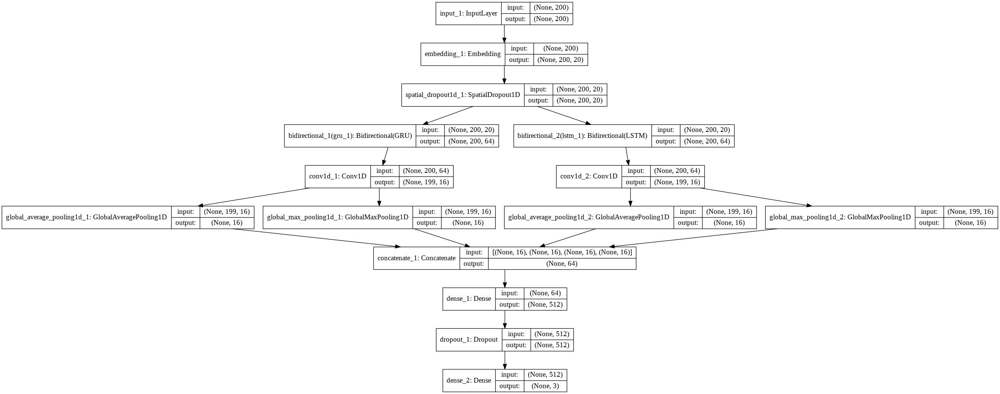

In [0]:
from IPython.display import Image
Image(filename='model_plot2.png') 

In [0]:
text_model.fit(x_train, y_train)

Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.


Train on 10540 samples, validate on 1172 samples
Epoch 1/5
10540/10540 [==============================] - 119s 11ms/step - loss: 0.7635 - accuracy: 0.6749 - val_loss: 0.6285 - val_accuracy: 0.7270
Epoch 2/5
10540/10540 [==============================] - 120s 11ms/step - loss: 0.5557 - accuracy: 0.7742 - val_loss: 0.5383 - val_accuracy: 0.7901
Epoch 3/5
10540/10540 [==============================] - 118s 11ms/step - loss: 0.4363 - accuracy: 0.8351 - val_loss: 0.5015 - val_accuracy: 0.7986
Epoch 4/5
10540/10540 [==============================] - 117s 11ms/step - loss: 0.3644 - accuracy: 0.8661 - val_loss: 0.5422 - val_accuracy: 0.7892
Epoch 5/5
10540/10540 [==============================] - 118s 11ms/step - loss: 0.3000 - accuracy: 0.8906 - val_loss: 0.5583 - val_accuracy: 0.7935


In [0]:
text_model.score(x_test, y_test)

0.8043032786885246

### **Explaining with SHAP Explaination (kernel Explaination)**


In [0]:
encoded_x_train = text_model.trasnform(x_train)
encoded_x_test = text_model.trasnform(x_test)

In [0]:
def prepare_explanation_words(pipeline, encoded_x):
    words = text_model.tokenizer.word_index
    num2word = {}
    for w in words.keys():
        num2word[words[w]] = w
    x_test_words = np.stack([
        np.array(list(map(
            lambda x: num2word.get(x, "NONE"), encoded_x[i])
                     )) for i in range(10)])

    return x_test_words

In [0]:
import shap
shap.initjs()
kernel_explainer = shap.KernelExplainer(text_model.model.predict, encoded_x_train[:10])
kernel_shap_values = kernel_explainer.shap_values(encoded_x_test[:10])

x_test_words = prepare_explanation_words(text_model, encoded_x_test)
y_pred = text_model.predict(x_test[:10])

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!
l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


In [0]:
shap.initjs()
print('Actual Category: %s, Predict Category: %s' % (y_test[6], y_pred[6]))

shap.force_plot(kernel_explainer.expected_value[0], kernel_shap_values[0][6], x_test_words[6])

Actual Category: 2, Predict Category: 2


In [0]:
shap.initjs()
print('Actual Category: %s, Predict Category: %s' % (y_test[5], y_pred[5]))

shap.force_plot(kernel_explainer.expected_value[0], kernel_shap_values[0][5], x_test_words[5])

Actual Category: 0, Predict Category: 0


In [0]:
shap.initjs()
print('Actual Category: %s, Predict Category: %s' % (y_test[2], y_pred[2]))

shap.force_plot(kernel_explainer.expected_value[0], kernel_shap_values[0][2], x_test_words[2])

Actual Category: 0, Predict Category: 0


#### Explain the Visualization



*   The "model output value" is the prediction of the explainer above. Similar to LIME explainer, the prediction is 62%. 


*   According to [paper](http://papers.nips.cc/paper/7062-a-unified-approach-to-interpreting-model-predictions.pdf) , the base value of 0.6234 is the mean of prediction of all y_test. That is why, the value is not differ from all of three examples.
*   Red or Blue Features that push the prediction higher (to the right) are shown in red, and those pushing the prediction lower are in blue.

*   Due to this model effect, SHAP has evenly attributes value on negative feature "not" , "guys" and positive feature "much" , "help"

*   This force plot of Kernel Explanation explains how different features pushed and pulled on the output to move it from the base_value to the model output value or prediction. The prediction of this kernel explanation is the probability or confidence that the review is 62% belong to predicted category  ("Negative" Class).

*   Above, the word "much", "help" , etc on the right-hand side pushing the prediction from 1 to 0.62 and even lower than the base value of 0.6234. We can see that from the base value of 0.6234, the features have pushed to bring the output to 0.62.



## **Explaining with Lime**

Sample 6: last 80 words (only part used by the model)
--------------------------------------------------
USAirways what about AA miles for USAir flights booked through American
--------------------------------------------------
Probability(positive) = 0.057067774
True class:  2


split() requires a non-empty pattern match.


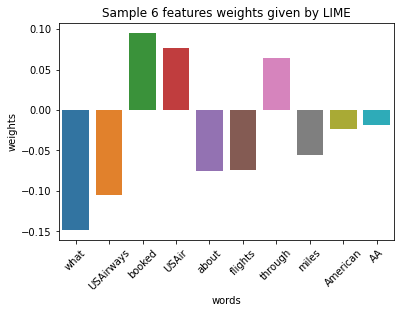

In [0]:
import seaborn as sns
%matplotlib inline
from collections import OrderedDict
from lime.lime_text import LimeTextExplainer

import seaborn as sns
sns.despine()
# We choose a sample from test set
idx =6
idx2 =5
idx3=2
text_sample = x_test[idx]
text_sample2 = x_test[idx2]
text_sample3 = x_test[idx3]
class_names = ['Negative', 'Positive','Neutral']

print('Sample {}: last 80 words (only part used by the model)'.format(idx))
print('-'*50)
print(" ".join(text_sample.split()[-80:]))
print('-'*50)
print('Probability(positive) =', text_model.predict_proba([text_sample])[0,1])
print("True class: ",y_test[idx])

explainer = LimeTextExplainer(class_names=class_names)
explanation = explainer.explain_instance(text_sample, text_model.predict_proba, num_features=10)

weights = OrderedDict(explanation.as_list())
lime_weights = pd.DataFrame({'words': list(weights.keys()), 'weights': list(weights.values())})



sns.barplot(x="words", y="weights", data=lime_weights);
plt.xticks(rotation=45)
plt.title('Sample {} features weights given by LIME'.format(idx));

In [0]:
explanation.show_in_notebook(text=True)

Sample 5: last 80 words (only part used by the model)
--------------------------------------------------
united missing this wedding because of these delays would not be cool
--------------------------------------------------
Probability(positive) = 0.0049230526
True class:  0


split() requires a non-empty pattern match.


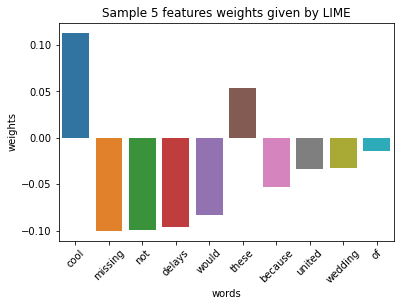

In [0]:
print('Sample {}: last 80 words (only part used by the model)'.format(idx2))
print('-'*50)
print(" ".join(text_sample2.split()[-80:]))
print('-'*50)
print('Probability(positive) =', text_model.predict_proba([text_sample2])[0,1])
print("True class: ",y_test[idx2])

explainer = LimeTextExplainer(class_names=class_names)
explanation = explainer.explain_instance(text_sample2, text_model.predict_proba, num_features=10)

weights = OrderedDict(explanation.as_list())
lime_weights = pd.DataFrame({'words': list(weights.keys()), 'weights': list(weights.values())})



sns.barplot(x="words", y="weights", data=lime_weights);
plt.xticks(rotation=45)
plt.title('Sample {} features weights given by LIME'.format(idx2));


In [0]:
explanation.show_in_notebook(text=True)

Sample 2: last 80 words (only part used by the model)
--------------------------------------------------
AmericanAir yes but not with much help from you guys
--------------------------------------------------
Probability(positive) = 0.16030203
True class:  0


split() requires a non-empty pattern match.


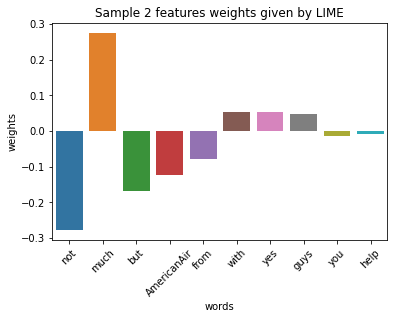

In [0]:
print('Sample {}: last 80 words (only part used by the model)'.format(idx3))
print('-'*50)
print(" ".join(text_sample3.split()[-80:]))
print('-'*50)
print('Probability(positive) =', text_model.predict_proba([text_sample3])[0,1])
print("True class: ",y_test[idx3])

explainer = LimeTextExplainer(class_names=class_names)
explanation = explainer.explain_instance(text_sample3, text_model.predict_proba, num_features=10)

weights = OrderedDict(explanation.as_list())
lime_weights = pd.DataFrame({'words': list(weights.keys()), 'weights': list(weights.values())})



sns.barplot(x="words", y="weights", data=lime_weights);
plt.xticks(rotation=45)
plt.title('Sample {} features weights given by LIME'.format(idx3));

In [0]:
explanation.show_in_notebook(text=True)

###Explain the Explainer Visualization: 



*   On the "Text with higligted words", the blue words made the classifier think that the review was more negative while the yellow words made the review seem more positive.
*   For this review, word “not” has the highest negative score for class Negative. We are able to see it clearly that the word “not” on its own is a negative signal but the phrase “AmericanAir yes ...” is a very positive signal. And the “but” is such a strong negative signal because it negates the word “yes” and any positive word before.

*   The explainer predicts that this review should be labeled as "negative" with the probability of 62%.
*   The word "not" support 28% for "Negative" probabilites prediction the if we remove it from the review the probability will drop to 34% for "Negative" class. (64%-28%).

*   In this model of Bi-Gru-LSTM-CNN the explainer seems to be more confidence on giving the reasonable Negative and Positive weight for each word, this phenomenone will be disscused later in the review of both model on explainer model.


With LIME methods of explanation, it is easy for Human to intrepret and understand the prediction. LIME allows us to extract some important word that mostly contribute to the prediction, and even give the rational number "Negative" or "Positive" contribution of each word of sample.



## Explaining with Anchor

In [0]:
sample_ids = [6]
for idx in sample_ids:
  print('Index: %d, Feature: %s' % (idx, x_test[idx]))
  print('True Label: %s' % (y_test[idx]))
  class_names = ['negative','positive','neutral']
  estimator = text_model.predict
  explainer = anchor_text.AnchorText(spacy_nlp, class_names, use_unk_distribution=True)
  exp = explainer.explain_instance(x_test[idx], estimator, threshold=0.8, use_proba=True, batch_size=30)
  max_pred = 2
  print('Key Singal from Anchors: %s' % (' AND '.join(exp.names())))
  print('Precision: %.2f' % exp.precision())
  print()

  exp.show_in_notebook()


Index: 6, Feature: USAirways what about AA miles for USAir flights booked through American
True Label: 2
Key Singal from Anchors: 
Precision: 0.97



In [0]:
sample_ids = [5]
for idx in sample_ids:
  print('Index: %d, Feature: %s' % (idx, x_test[idx]))
  print('True Label: %s' % (y_test[idx]))
  class_names = ['negative','positive','neutral']
  estimator = text_model.predict
  explainer = anchor_text.AnchorText(spacy_nlp, class_names, use_unk_distribution=True)
  exp = explainer.explain_instance(x_test[idx], estimator, threshold=0.8, use_proba=True, batch_size=30)
  max_pred = 2
  print('Key Singal from Anchors: %s' % (' AND '.join(exp.names())))
  print('Precision: %.2f' % exp.precision())
  print()

  exp.show_in_notebook()

Index: 5, Feature: united missing this wedding because of these delays would not be cool
True Label: 0
Key Singal from Anchors: missing
Precision: 0.96



In [0]:
sample_ids = [2]
for idx in sample_ids:
  print('Index: %d, Feature: %s' % (idx, x_test[idx]))
  print('True Label: %s' % (y_test[idx]))
  class_names = ['negative','positive','neutral']
  estimator = text_model.predict
  explainer = anchor_text.AnchorText(spacy_nlp, class_names, use_unk_distribution=True)
  exp = explainer.explain_instance(x_test[idx], estimator, threshold=0.8, use_proba=True, batch_size=30)
  max_pred = 2
  print('Key Singal from Anchors: %s' % (' AND '.join(exp.names())))
  print('Precision: %.2f' % exp.precision())
  print()

  exp.show_in_notebook()

Index: 2, Feature: AmericanAir yes but not with much help from you guys
True Label: 0
Key Singal from Anchors: not
Precision: 0.83



#### Explain Anchor Explainer



*   From the visualization above, Anchor Explainer clasify the review as "Negative" class. 
*   On the example above, Anchor succesfully import the word "not" as the feature that contributes for the predicted class.
*   Anchor predict 83,2% that reviews is belong to negative class
*   On this Bi-Gru LSTM CNN, anchor able to import the word/feature that will contributes on predicted class, this is different from the Bi-LSTM model. On Bi-LSTM model anchor unable to import the feature on the last example. The reason behind this problem will be disscussed later on the model effects below.







# **Model Effect on Each Explainer**

## **LIME**

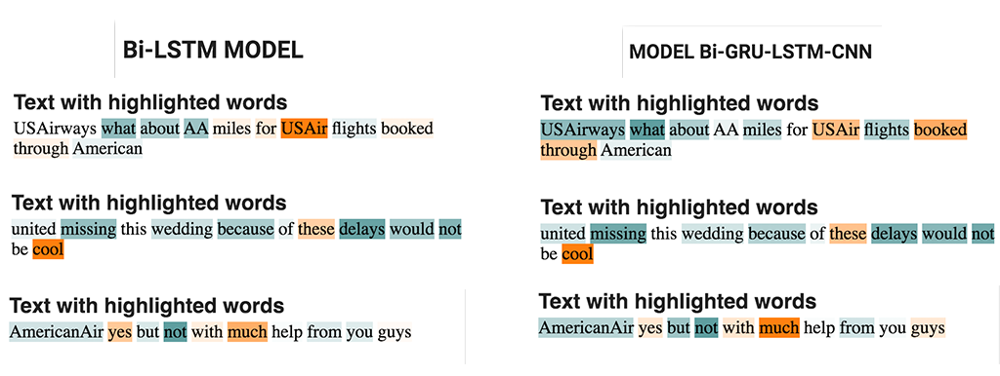

In [0]:
from IPython.display import Image
Image(filename='Model Compare LIME.png')

A comparison of these word-level relevance scores between  Bi-LSTM Model and Bi-Gru-LSTM-CNN in a document classification task shows that the decisions of both model are based on fewer, more semantically meaningful words.

The result of explainability method above are showing insignificant different between two models. However we could learn the behavior of the model from the interpretation shown above. Bi-Gru-LSTM-CNN model take many consideration before doing the prediction,  we could see from the way the model predict the class such as in sample number 3 with sentence "AmericanAir yes but not with much help from you guys". Bi-Gru-LSTM-CNN model identified more word that influence the prediction task into consideration compared to the Simple Bi-LSTM model which only take a few word. This probably because Bi-Gru-LSTM-CNN has more layer and complex architecture than simple Bi-LSTM model. 



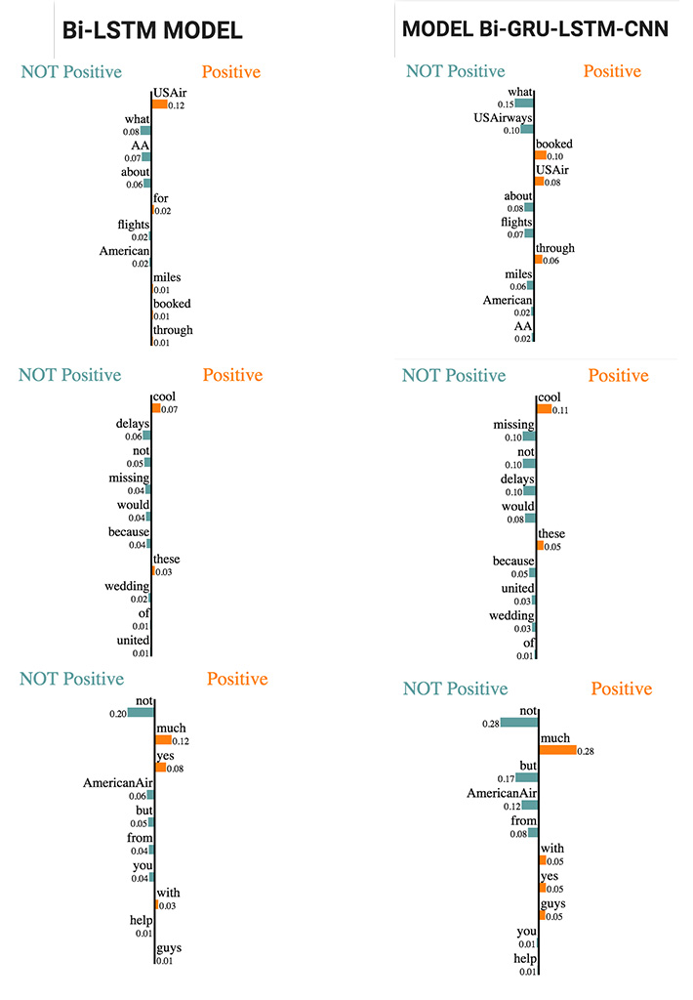

In [0]:
from IPython.display import Image
Image(filename='Model Compare LIME2.jpg')

Both models perform a different result of the explanation seen in the diagram above. The result obtained from both model gives a little different in the number of probability for each word and some word identify differently on two models, such as in sample 3 we could see that on Bi-LSTM model only 3 that identify as the word for the positive class which is, "much", "yes", and "with" compare to Bi-Gru-LSTM-CNN there are 4 of the word identified as the word for positive with additional "guys" word. It is not a big difference as a result since we could also see on the model's accuracy of both models they presented a small difference where the Bi-LSTM model has 79% while Bi-Gru-LSTM-CNN has 80% accuracy.

## **SHAP**

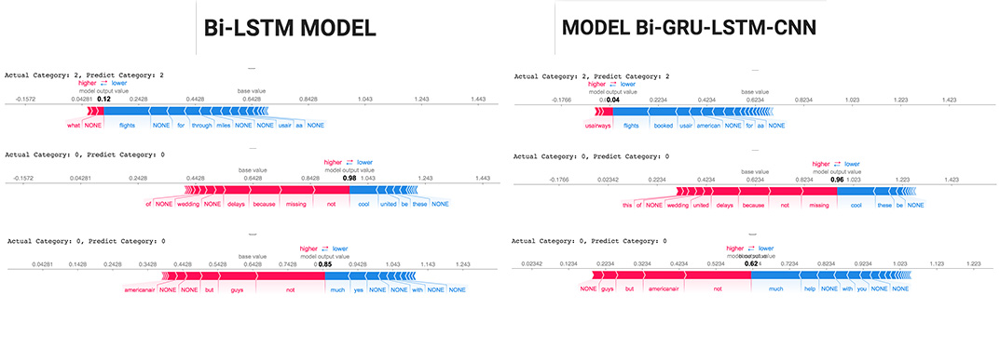

In [0]:
from IPython.display import Image
Image(filename='Model Compare SHAP.jpg')

Similar to LIME, SHAP also provided different results from both models. Moreover, we could see that some sample 1 and 2 show a small number of differences between obtained output value, however, sample 3 shows a big difference of the obtained output value for both model, as it seen Bi-LSTM model on sample 3 has the output value 0.85 while Model Bi-Gru-LSTM-CNN has 0.68. 

## **ANCHOR**

**Example 1**

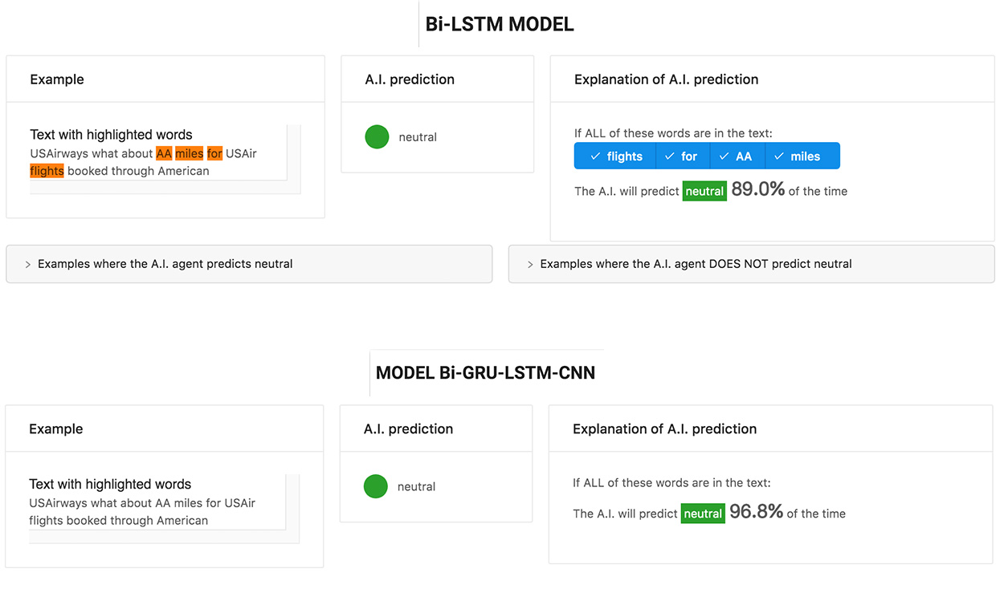

In [0]:
from IPython.display import Image
Image(filename='Model Compare Anchor1.jpg')

The graph above shows that the Anchor explainer on model Bi-LSTM has a lower probability for predicting the tweet to "Neutral" class (89%) than on model Bi-Gru-LSTM-CNN (96.8%). In contrast, model Bi-LSTM with Anchor method has provided a list of the words that have more influence on prediction problem which are, "flight", "for", "AA", and "miles", however the model Bi-Gru-LSTM-CNN Anchor does not provide any word.

**Example 2**

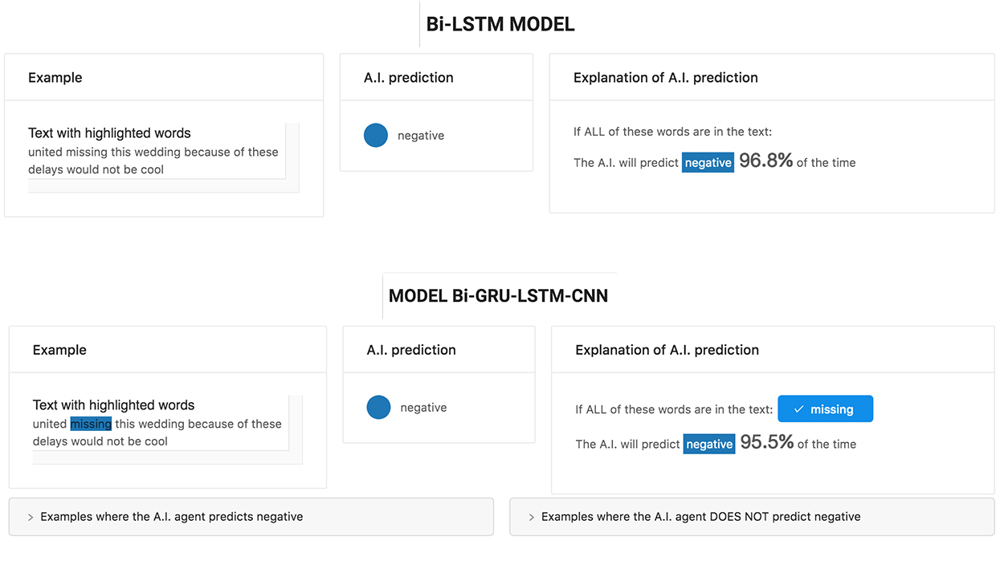

In [0]:
from IPython.display import Image
Image(filename='Model Compare Anchor2 copy.jpg')

On sample 2, both model share a very small difference on the probability percentage where Bi-Gru-LSTM-CNN model has a smaller number of percentage (95%) and has the identified word influence for the prediction ("missing") otherwise, Bi-LSTM model has a bigger number of percentage (96.8%) and Anchor does not provide any identified word.

**Example 3**

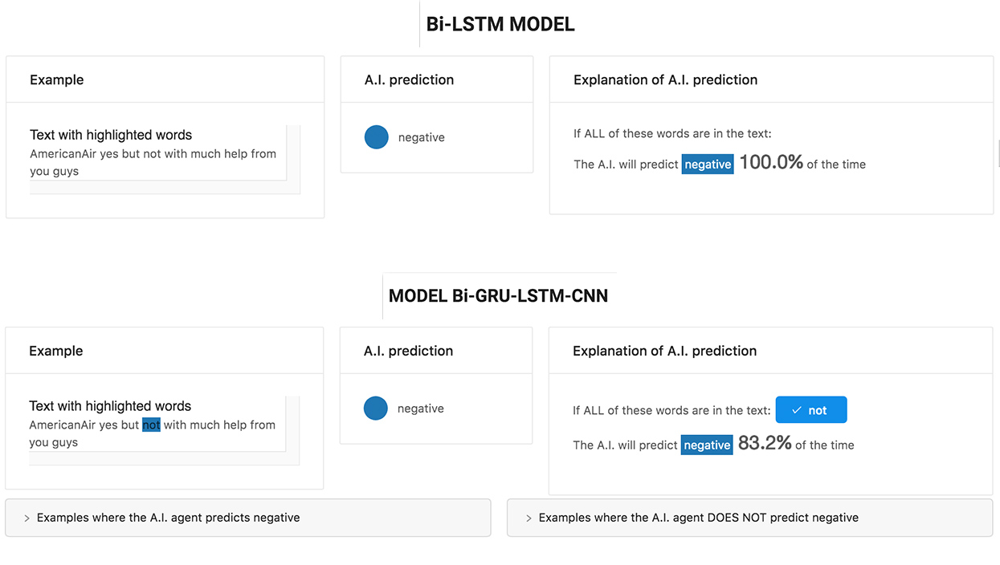

In [0]:
from IPython.display import Image
Image(filename='Model Compare Anchor3 copy.jpg')

Similarly, in sample number 3, Bi-LSTM model perform bigger number of probability which is 100% than Bi-Gru-LSTM-CNN model which is only 83.2%. However, on Bi-Gru-LSTM-CNN model, Anchor provides the identified word "not" that influences the prediction.

## **Summary**

We gained a few key insights from our results. Model Bi-LSTM has 79% accuracy for the evaluation and Bi-Gru-LSTM-CNN has 80% accuracy. This minor different, probably because of the additional Gru and CNN layer on the architecture. In spite of the better accuracy which is really small, provided by Bi-Gru-LSTM-CNN model, if we look into the complex of the architecture, Bi-Gru-LSTM-CNN must have more time consuming compared to the simple Bi-LSTM model. 

  The result for the explainability obtained from 3 different methods shows different values in both models.

# **What to take away?**



*   About the computation time, SHAP takes more time comparing two other explainers.
*   Anchor explainer exists to solve the Multiclass sentiment prediction problem in LIME explainer

![alt text](https://miro.medium.com/max/616/1*R05mGuGehKlZcIX50w4cbA.png)

From Ribeiro, Singh, and Guestrin 2018

As we can see in the picture above, the feature word “not” provides a positive influence on the left hand side while on the other hand, it is also heavily negative influence on the right hand side. It seems there is no problem if we look only on one explanation, however, if we expand our view for both explanations it will make us confuse.


*   In Achor explainer we cannot use classification name literally word to word, we need to encode it first because the label can only accept integer.
*   Shap explainer in our model which is KernelExplainer using LIME and Shapley values. That is why the result between LIME and SHAP is almost similar.





# **Future works!** or more to our hopes of this project :)



*   We hope we can analyze further and understanding the Deep Learning Model by using Explainer.
*   How explainer help us to understand how the neural network actually work? because we believe that neural network doesn't always have to be black boxed :)




